In [1]:
import numpy as np
import holoviews as hv
hv.notebook_extension()

In [2]:
def sine(x, phase=0, freq=100):
    return np.sin((freq * x + phase))
phases = np.linspace(0, 2*np.pi, 11)
freqs = np.linspace(50, 150, 5)

In [3]:
dist = np.linspace(-0.5, 0.5, 202)
x, y = np.meshgrid(dist, dist)
grid = (x**2+y**2)

In [4]:
freq1 = hv.Image(sine(grid, freq=50)) + hv.Curve(zip(dist,sine(dist**2, freq=50)))
freq2 = hv.Image(sine(grid, freq=200)) + hv.Curve(zip(dist,sine(dist**2, freq=200)))

:Layout
   .Image.I   :Image   [x,y]   (z)
   .Curve.I   :Curve   [x]   (y)
   .Image.II  :Image   [x,y]   (z)
   .Curve.III :Curve   [x]   (y)
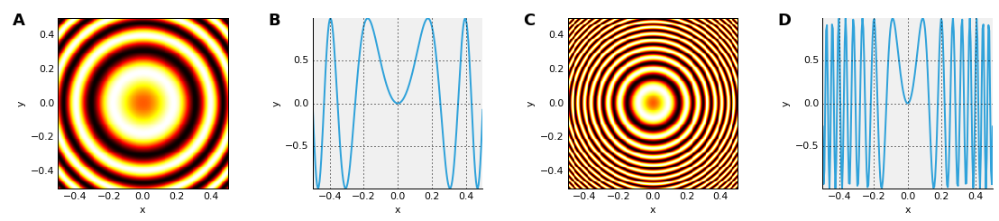

In [5]:
(freq1 + freq2)

:Layout
   .Image.I   :Image   [x,y]   (z)
   .Curve.I   :Curve   [x]   (y)
   .Image.II  :Image   [x,y]   (z)
   .Curve.III :Curve   [x]   (y)
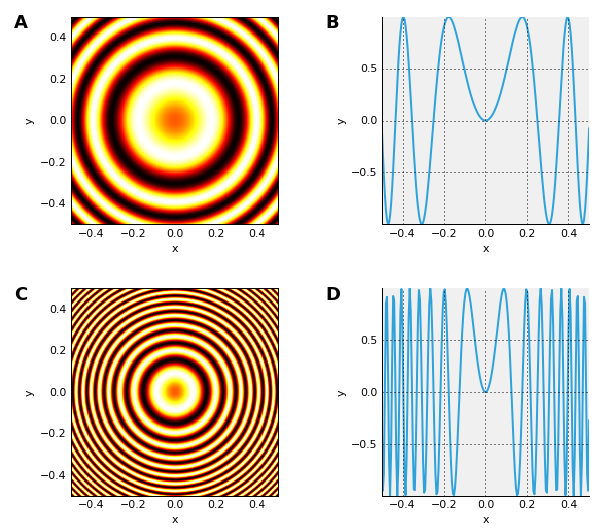

In [6]:
(freq1 + freq2).cols(2)

In [7]:
dimensions = ['Phase', 'Frequency']
keys = [(p, f) for p in phases for f in freqs]

b':HoloMap   [Phase,Frequency]\n   :Image   [x,y]   (Amplitude)'
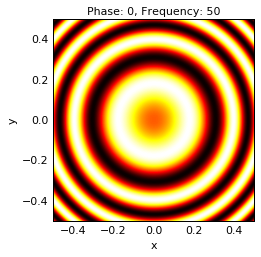
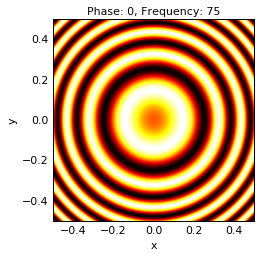
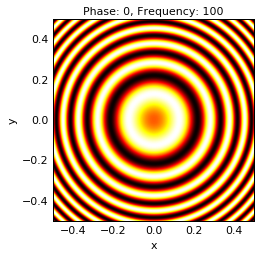
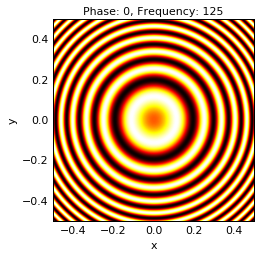
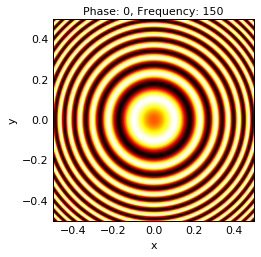
...
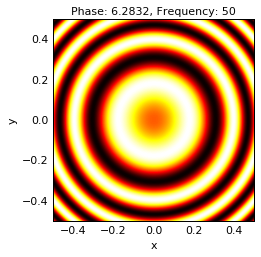
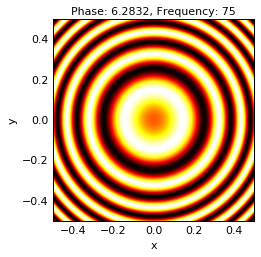
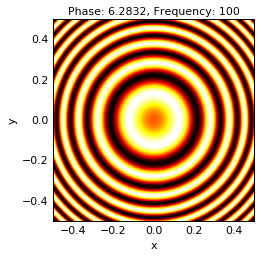
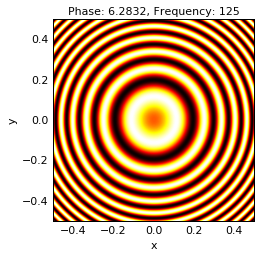
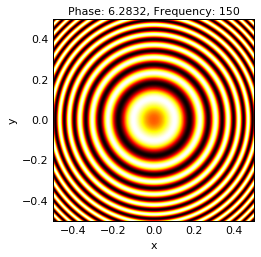

In [9]:
items = [(k, hv.Image(sine(grid, *k), vdims=['Amplitude'])) for k in keys]
circular_wave = hv.HoloMap(items, kdims=dimensions)
circular_wave

:Layout
   .HoloMap.I  :HoloMap   [Phase,Frequency]
      :Image   [x,y]   (Amplitude)
   .HoloMap.II :HoloMap   [Phase,Frequency]
      :Curve   [x]   (y)
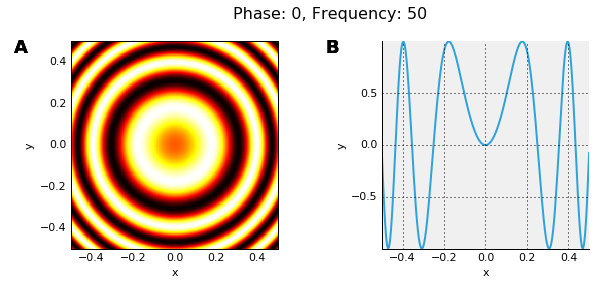
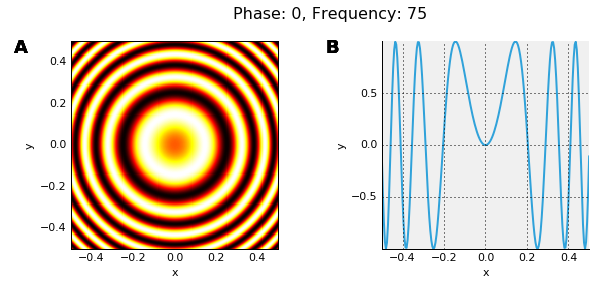
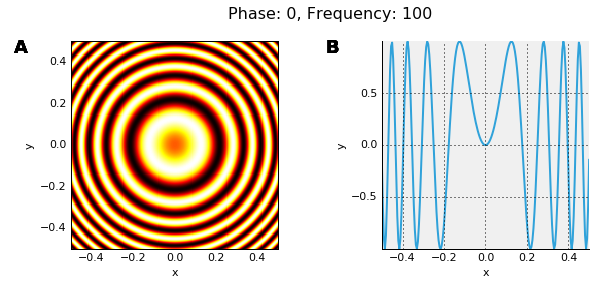
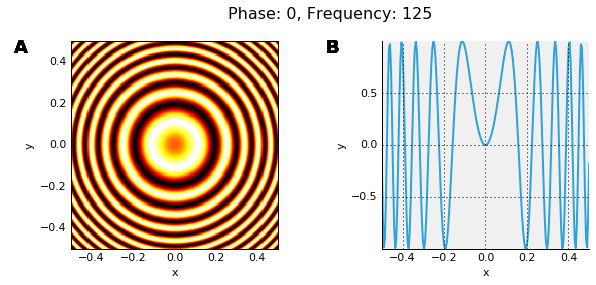
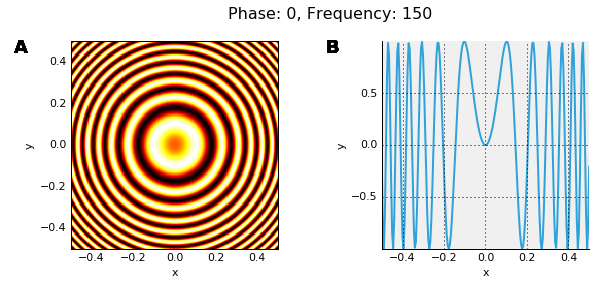
...
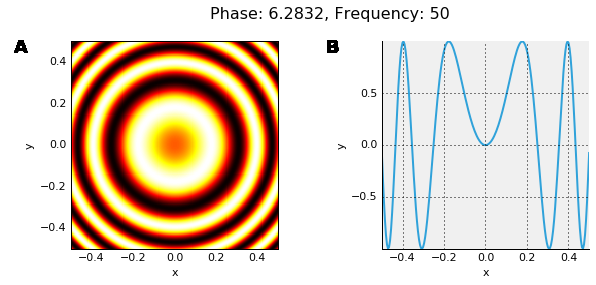
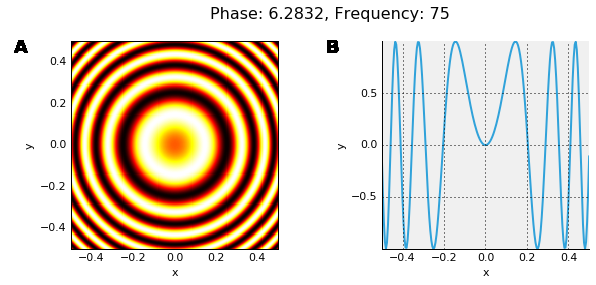
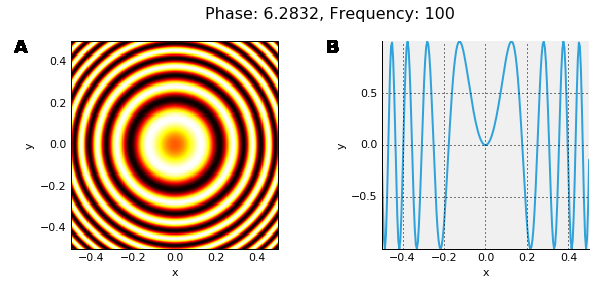
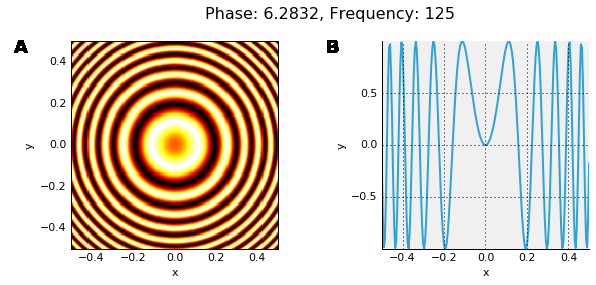
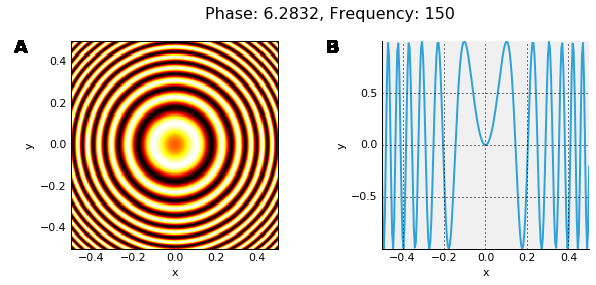

In [10]:
items = [(k, hv.Curve(zip(dist, sine(dist**2, *k)))) for k in keys]
sections = hv.HoloMap(items, kdims=dimensions)
circular_wave + sections

:Layout
   .HoloMap.I  :HoloMap   [Phase,Frequency]
      :Overlay
         .Image.I  :Image   [x,y]   (Amplitude)
         .Points.I :Points   [x,y]
   .HoloMap.II :HoloMap   [Frequency]
      :Curve   [Phase]   (Amplitude)
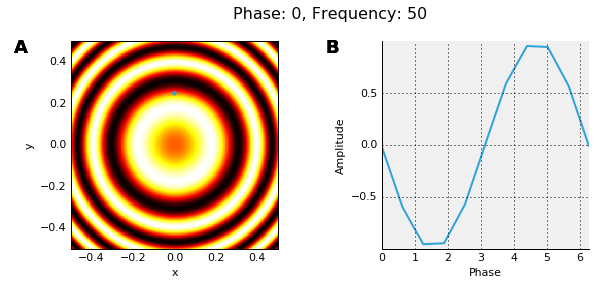
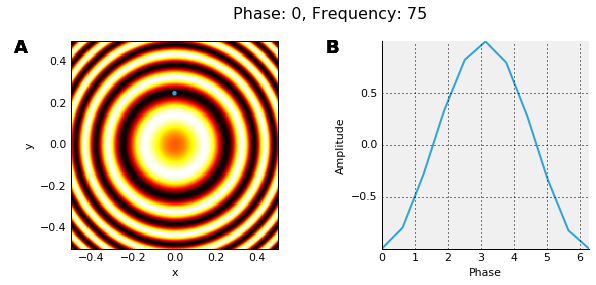
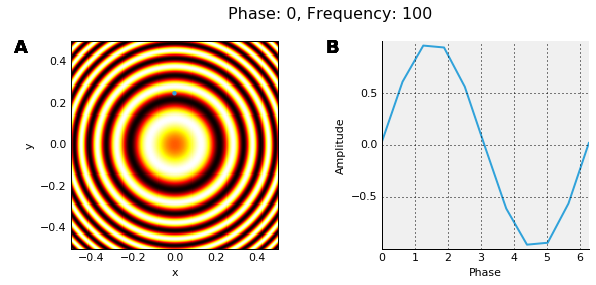
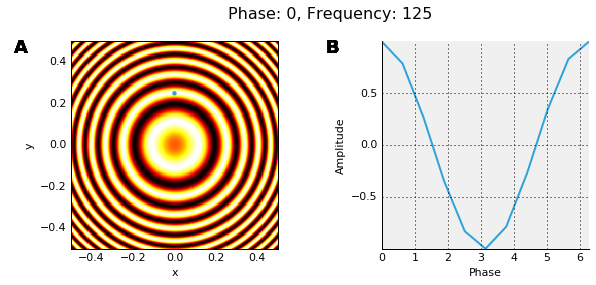
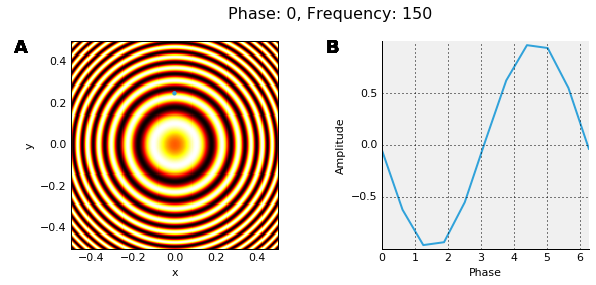
...
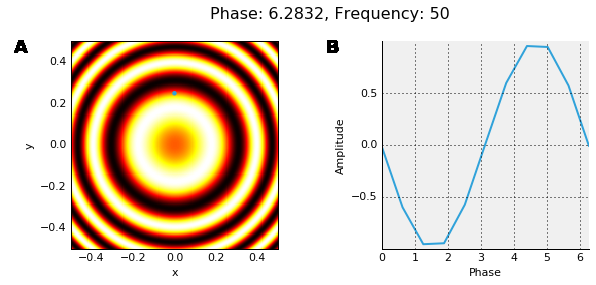
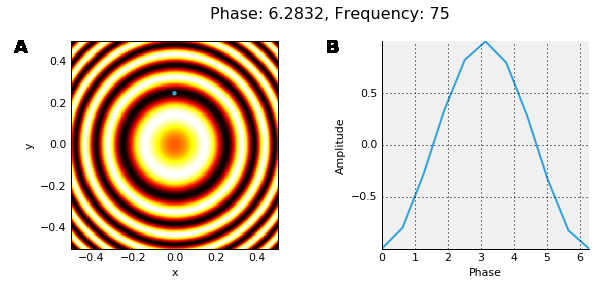
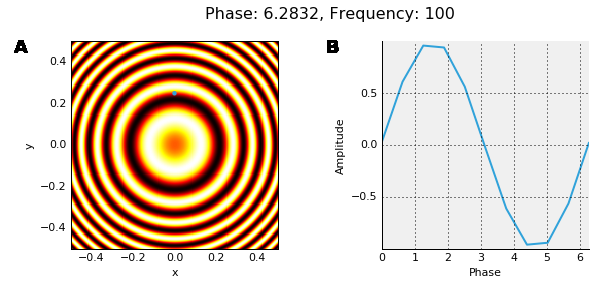
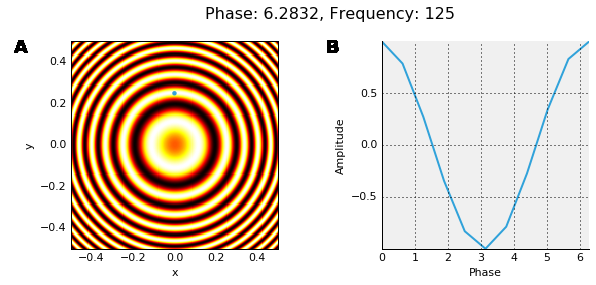
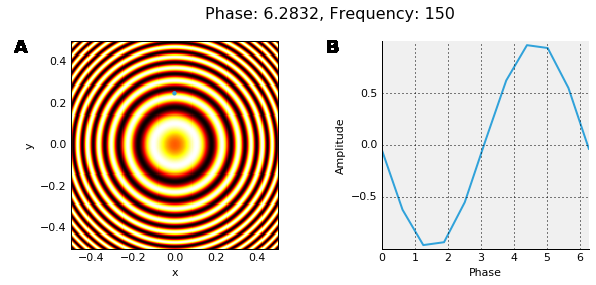

In [11]:
sample_pos = (0, 0.25)
annotated = circular_wave * hv.Points([sample_pos])
sample = circular_wave.sample(samples=[sample_pos]).to.curve('Phase', 'Amplitude',
                                                            ['Frequency'])
annotated + sample

In [12]:
red_wave = circular_wave(options={'Image':{'style':{'cmap':'RdGy'}}})

b':HoloMap   [Phase,Frequency]\n   :Image   [x,y]   (Amplitude)'
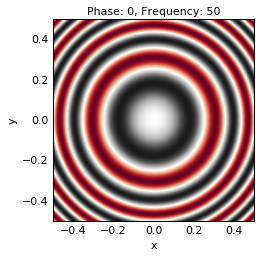
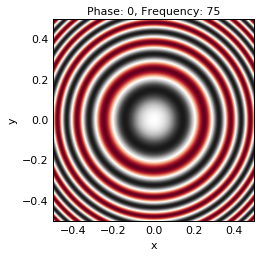
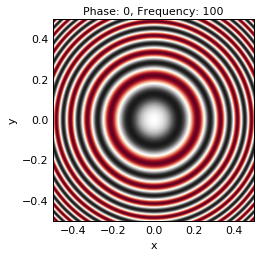
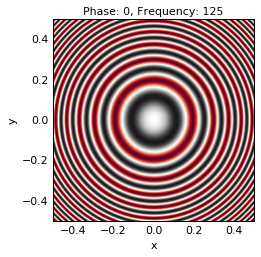
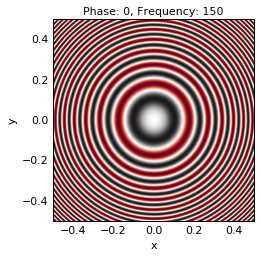
...
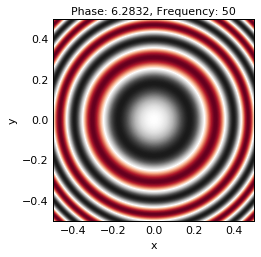
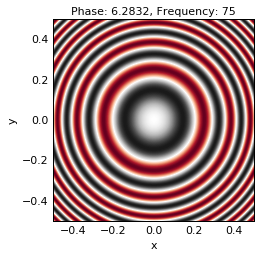
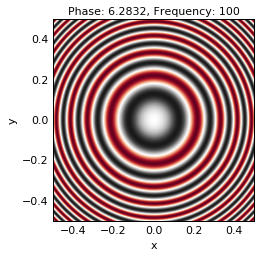
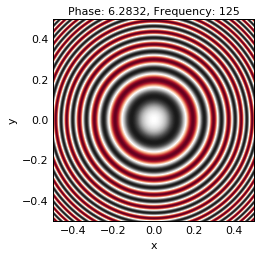
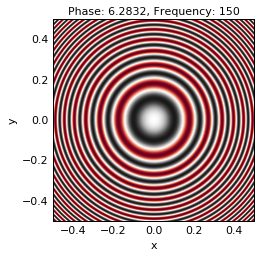

In [13]:
red_wave

:Layout
   .Image.I  :Image   [x,y]   (z)
   .Image.II :Image   [x,y]   (z)
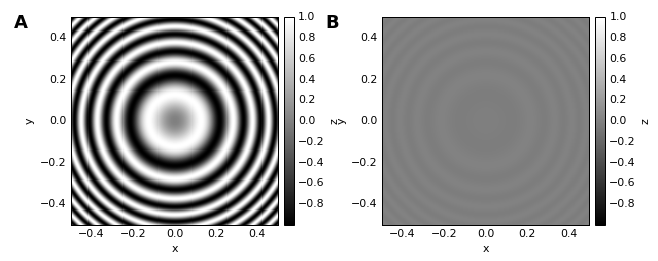

In [17]:
%opts Image [colorbar=True] (cmap='gray')
comparison = hv.Image(sine(grid)) + hv.Image(sine(grid, phase=np.pi)*0.02)
comparison